# Prepare Data

## Import Libs We need

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime as dt
import numpy as np
from scipy.stats import kurtosis
from scipy.signal import butter, filtfilt
from scipy.fft import fft, fftfreq
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import accuracy_score
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

## Read Dataset

In [2]:
df_healthy = pd.read_csv(r'D:\STUDY\PHM\project\dataset\healthy.csv')
df_unhealthy100 = pd.read_csv(r'D:\STUDY\PHM\project\dataset\0.7inner-100watt.csv')
df_unhealthy200 = pd.read_csv(r'D:\STUDY\PHM\project\dataset\0.7inner-200watt.csv')

## Preprocess data

### reduce redundant data

In [3]:
df_healthy.columns = df_healthy.columns.str.strip()
df_unhealthy100.columns = df_unhealthy100.columns.str.strip()
df_unhealthy200.columns = df_unhealthy200.columns.str.strip()

In [4]:
def deduplication(data, timestamp_column='Time Stamp'):
    """
    Groups the data by a timestamp column and calculates the mean for all other columns.

    Parameters:
        data (pd.DataFrame): The input DataFrame.
        timestamp_column (str): The name of the column to group by. Default is 'Time Stamp'.

    Returns:
        pd.DataFrame: A new DataFrame with the average values grouped by the timestamp column.
    """
    if timestamp_column not in data.columns:
        raise ValueError(f"The column '{timestamp_column}' does not exist in the DataFrame.")
    
    return data.groupby(timestamp_column, as_index=False).mean()

In [5]:
df_healthy = deduplication(df_healthy)
df_healthy.head()

,Time Stamp,Current-A,Current-B,Current-C
0,13:28:15,2.450055,2.201960,2.775834
1,13:28:16,2.572983,2.218462,2.651198
2,13:28:17,2.282460,2.704436,2.502603
3,13:28:18,2.721960,2.348980,2.397976
4,13:28:19,2.268390,2.540808,2.659037


In [6]:
df_unhealthy100 = deduplication(df_unhealthy100)
df_unhealthy100.head()

,Time Stamp,Current-A,Current-B,Current-C
0,13:34:14,2.114503,2.792428,2.577308
1,13:34:15,2.338328,3.056456,2.135520
2,13:34:16,2.743287,2.799158,1.990709
3,13:34:17,3.021263,2.354739,2.117643
4,13:34:18,2.990199,2.001818,2.459935


In [7]:
df_unhealthy200 = deduplication(df_unhealthy200)
df_unhealthy200.head()

,Time Stamp,Current-A,Current-B,Current-C
0,13:47:05,2.081581,3.065060,2.370644
1,13:47:06,2.099670,2.376575,2.959525
2,13:47:07,2.850557,1.921852,2.658805
3,13:47:08,2.898396,2.584047,2.035346
4,13:47:09,2.150942,3.072036,2.299676


### Check the dataframe

In [8]:
df_healthy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 265 entries, 0 to 264
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Time Stamp  265 non-null    object 
 1   Current-A   265 non-null    float64
 2   Current-B   265 non-null    float64
 3   Current-C   265 non-null    float64
dtypes: float64(3), object(1)
memory usage: 8.4+ KB


In [9]:
df_unhealthy100.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 325 entries, 0 to 324
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Time Stamp  325 non-null    object 
 1   Current-A   325 non-null    float64
 2   Current-B   325 non-null    float64
 3   Current-C   325 non-null    float64
dtypes: float64(3), object(1)
memory usage: 10.3+ KB


In [10]:
df_unhealthy200.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284 entries, 0 to 283
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Time Stamp  284 non-null    object 
 1   Current-A   284 non-null    float64
 2   Current-B   284 non-null    float64
 3   Current-C   284 non-null    float64
dtypes: float64(3), object(1)
memory usage: 9.0+ KB


## Process Data

### Transfer the timestamp to timeseries from 0

In [11]:
def time_process(data, timestamp_column='Time Stamp'):
    """
    Resets the timestamp column to start from zero.
    
    Parameters:
        data (pd.DataFrame): The input DataFrame.
        timestamp_column (str): The name of the column containing timestamps.

    Returns:
        pd.DataFrame: A new DataFrame with the adjusted timestamp column.
    """
    # Convert the timestamp column to timedelta
    data['Time'] = pd.to_timedelta(data[timestamp_column]).dt.total_seconds()
    
    # Subtract the minimum timestamp to start from zero
    data['Time'] -= data['Time'].min()
    
    return data

In [12]:
df_healthy = time_process(df_healthy)
df_healthy.head()

,Time Stamp,Current-A,Current-B,Current-C,Time
0,13:28:15,2.450055,2.201960,2.775834,0.0
1,13:28:16,2.572983,2.218462,2.651198,1.0
2,13:28:17,2.282460,2.704436,2.502603,2.0
3,13:28:18,2.721960,2.348980,2.397976,3.0
4,13:28:19,2.268390,2.540808,2.659037,4.0


In [13]:
df_unhealthy100 = time_process(df_unhealthy100)
df_unhealthy100.head()

,Time Stamp,Current-A,Current-B,Current-C,Time
0,13:34:14,2.114503,2.792428,2.577308,0.0
1,13:34:15,2.338328,3.056456,2.135520,1.0
2,13:34:16,2.743287,2.799158,1.990709,2.0
3,13:34:17,3.021263,2.354739,2.117643,3.0
4,13:34:18,2.990199,2.001818,2.459935,4.0


In [14]:
df_unhealthy200 = time_process(df_unhealthy200)
df_unhealthy200.head()

,Time Stamp,Current-A,Current-B,Current-C,Time
0,13:47:05,2.081581,3.065060,2.370644,0.0
1,13:47:06,2.099670,2.376575,2.959525,1.0
2,13:47:07,2.850557,1.921852,2.658805,2.0
3,13:47:08,2.898396,2.584047,2.035346,3.0
4,13:47:09,2.150942,3.072036,2.299676,4.0


### Add extra rows to keep them the same length

In [15]:
def add_rows(data, aim_len = len(df_unhealthy100)):
    current_len = len(data)

    if(current_len >= aim_len):
        return data
    else:
        extra_rows = pd.DataFrame({
            'Time Stamp': [np.nan] * (aim_len - current_len),
            ' Current-A': [np.nan] * (aim_len - current_len),
            ' Current-B': [np.nan] * (aim_len - current_len),
            ' Current-C': [np.nan] * (aim_len - current_len),
            'Time': [current_len + i for i in range(aim_len - current_len)]
        })
        data = pd.concat([data, extra_rows], ignore_index=True)
        return data

In [16]:
df_healthy = add_rows(df_healthy)
df_healthy.tail(5)

,Time Stamp,Current-A,Current-B,Current-C,Time,Current-A,Current-B,Current-C
320,NaN,NaN,NaN,NaN,320.0,NaN,NaN,NaN
321,NaN,NaN,NaN,NaN,321.0,NaN,NaN,NaN
322,NaN,NaN,NaN,NaN,322.0,NaN,NaN,NaN
323,NaN,NaN,NaN,NaN,323.0,NaN,NaN,NaN
324,NaN,NaN,NaN,NaN,324.0,NaN,NaN,NaN


In [17]:
df_unhealthy200 = add_rows(df_unhealthy200)
df_unhealthy200.tail(5)

,Time Stamp,Current-A,Current-B,Current-C,Time,Current-A,Current-B,Current-C
320,NaN,NaN,NaN,NaN,320.0,NaN,NaN,NaN
321,NaN,NaN,NaN,NaN,321.0,NaN,NaN,NaN
322,NaN,NaN,NaN,NaN,322.0,NaN,NaN,NaN
323,NaN,NaN,NaN,NaN,323.0,NaN,NaN,NaN
324,NaN,NaN,NaN,NaN,324.0,NaN,NaN,NaN


### Plot figure

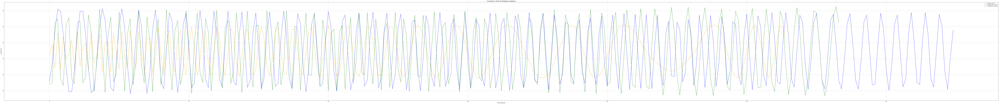

In [18]:
plt.figure(figsize=(200, 20))

plt.plot(df_healthy['Time'], df_healthy['Current-A'], label = 'healthy-currentA', color = 'orange', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy100['Current-A'], label = 'unhealthy100-currentA', color = 'blue', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy200['Current-A'], label = 'unhealthy200-currentA', color = 'green', linestyle='-')


plt.title('CurrentA vs Time for Multiple conditions', fontsize=16)
plt.xlabel('Time (seconds)', fontsize=12)
plt.ylabel('Current (A)', fontsize=12)
plt.legend()
plt.grid(True)

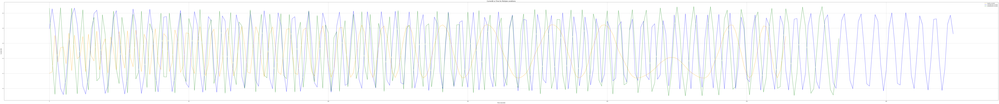

In [19]:
plt.figure(figsize=(200, 20))

plt.plot(df_healthy['Time'], df_healthy['Current-B'], label = 'healthy-currentB', color = 'orange', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy100['Current-B'], label = 'unhealthy100-currentB', color = 'blue', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy200['Current-B'], label = 'unhealthy200-currentB', color = 'green', linestyle='-')


plt.title('CurrentB vs Time for Multiple conditions', fontsize=16)
plt.xlabel('Time (seconds)', fontsize=12)
plt.ylabel('Current (B)', fontsize=12)
plt.legend()
plt.grid(True)

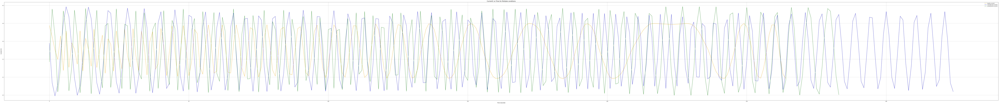

In [20]:
plt.figure(figsize=(200, 20))

plt.plot(df_healthy['Time'], df_healthy['Current-C'], label = 'healthy-currentC', color = 'orange', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy100['Current-C'], label = 'unhealthy100-currentC', color = 'blue', linestyle='-')
plt.plot(df_unhealthy100['Time'], df_unhealthy200['Current-C'], label = 'unhealthy200-currentC', color = 'green', linestyle='-')


plt.title('CurrentC vs Time for Multiple conditions', fontsize=16)
plt.xlabel('Time (seconds)', fontsize=12)
plt.ylabel('Current (C)', fontsize=12)
plt.legend()
plt.grid(True)

### get feaatures

#### Choose useful rows

In [21]:
df_healthy = df_healthy.iloc[:150]
df_unhealthy200 = df_unhealthy200.iloc[:284]

#### key algorithm to extract features we want

In [22]:
def f1_PTV(current, step):
    """
    calculate the value of peak to valley
    
    Para step : the length of time slice
    """
    PTV = []
    for i in range(1, (len(current) -step-1) ):
        
        data = current[i:i + step]
        max_min_diff = max(data) - min(data)
        PTV.append(max_min_diff)
    return PTV

In [23]:
def f2_frequency(current, step):
    """
    This function intends to find average frequency in a time slice 
    """
    average_frequency = []
    count = 0
    for t in range(1, (len(current) -step-1) ):
        for i in range(t, (t+step)):
            if current[i - 1] <= current[i] >= current[i + 1]:
                count += 1
            elif current[i - 1] >= current[i] <= current[i + 1]:
                count += 1
        average_frequency.append(2*count/step)
        count = 0
    return average_frequency

In [24]:
def f3_kurtosis(current, step):
    """
    reveal the kurtosis of each time slice
    """
    kurt = []
    for i in range(1, (len(current) -step-1) ):
        data = current[i:i + step]
        kurtosis_of_data = kurtosis(data)
        kurt.append(kurtosis_of_data)
    return kurt

In [25]:
def extract_features(df, name):
    """
    Feature 1: PTV
    Feature 2: frequency
    Feature 3: normal or abnormal(0/1)
    Para df : the dataframe
    Para name : the name of the data frame
    """
    step = 10
    column_PTV = f1_PTV(df['Current-A'], step)
    column_frequency = f2_frequency(df['Current-A'], step)
    column_kurt = f3_kurtosis(df['Current-A'], step)
    df1 = pd.DataFrame({'PTV': column_PTV, 'Frequency': column_frequency, 'Kurtosis': column_kurt})
    if name == 'df_healthy':
        df2 = df1.assign(Malfunction=0)
    else:
        df2 = df1.assign(Malfunction=1)
    return df2

#### implement extraction

In [26]:
df_healthy_feature = extract_features(df_healthy,'df_healthy')
df_healthy_feature.head()

,PTV,Frequency,Kurtosis,Malfunction
0,0.468432,1.8,-1.562570,0
1,0.468432,1.8,-1.646702,0
2,0.468432,1.6,-1.526954,0
3,0.468432,1.6,-1.400648,0
4,0.479403,1.6,-1.391275,0


In [27]:
df_unhealthy100_feature = extract_features(df_unhealthy100,'df_unhealthy100')
df_unhealthy100_feature.head()

,PTV,Frequency,Kurtosis,Malfunction
0,1.034392,0.4,-1.323158,1
1,1.034392,0.4,-1.386226,1
2,1.034392,0.6,-1.474692,1
3,1.005102,0.4,-1.372788,1
4,1.005102,0.4,-1.349624,1


In [28]:
df_unhealthy200_feature = extract_features(df_unhealthy200,'df_unhealthy200')
df_unhealthy200_feature.head()

,PTV,Frequency,Kurtosis,Malfunction
0,0.847048,0.8,-1.967818,1
1,0.847048,1.0,-1.798908,1
2,0.847048,1.2,-1.969331,1
3,0.847048,1.0,-1.798977,1
4,0.879920,1.2,-1.951900,1


In [29]:
df_general = pd.concat([df_healthy_feature, df_unhealthy100_feature, df_unhealthy200_feature], axis = 0, ignore_index=True)
df_general.tail()

,PTV,Frequency,Kurtosis,Malfunction
718,1.094641,0.6,-1.479799,1
719,1.058915,0.6,-1.466312,1
720,1.058915,0.6,-1.178938,1
721,1.058915,0.6,-1.281297,1
722,1.058915,0.4,-1.465843,1


#### Nomalize the final data

In [30]:
scaler = MinMaxScaler()
normalized_data = scaler.fit_transform(df_general)
df_final = pd.DataFrame(normalized_data, columns=df_general.columns)
df_final.tail()

,PTV,Frequency,Kurtosis,Malfunction
718,0.988951,0.250,0.474510,1.0
719,0.932530,0.250,0.487582,1.0
720,0.932530,0.250,0.766137,1.0
721,0.932530,0.250,0.666919,1.0
722,0.932530,0.125,0.488037,1.0


# Signal Process

## Dominant Frequency Over Time

In [31]:
def perform_fft(signal, time, plot=True):
    """
    对信号执行快速傅里叶变换 (FFT)，并可视化频谱。

    参数:
        - signal: ndarray or list
          输入信号数据（一维数组或列表）。
        - time: ndarray or list
          时间数据，对应于输入信号的时间点。
        - plot: bool
          是否可视化时域信号和频域信号（默认 True）。

    返回:
        - frequencies: ndarray
          频率轴（单位为 Hz）。
        - amplitudes: ndarray
          对应频率的幅值。
    """
    # 确定采样频率
    fs = 1 # 假设时间间隔均匀
    N = len(signal)  # 数据点数

    # 执行 FFT
    yf = fft(signal)  # 进行傅里叶变换
    xf = fftfreq(N, 1/fs)[:N//2]  # 生成频率轴，只保留正频率部分
    amplitude = 2.0 / N * np.abs(yf[:N//2])  # 计算正频率的幅值

    # 可视化
    if plot:
        plt.figure(figsize=(12, 6))

        # 时域信号
        plt.subplot(2, 1, 1)
        plt.plot(time, signal, label='Time Domain Signal')
        plt.title('Time Domain Signal')
        plt.xlabel('Time (s)')
        plt.ylabel('Amplitude')
        plt.grid(True)

        # 频域信号
        plt.subplot(2, 1, 2)
        plt.plot(xf, amplitude, label='Frequency Domain Signal')
        plt.title('Frequency Domain Signal')
        plt.xlabel('Frequency (Hz)')
        plt.ylabel('Amplitude')
        plt.grid(True)

        plt.tight_layout()
        plt.show()

    return xf, amplitude

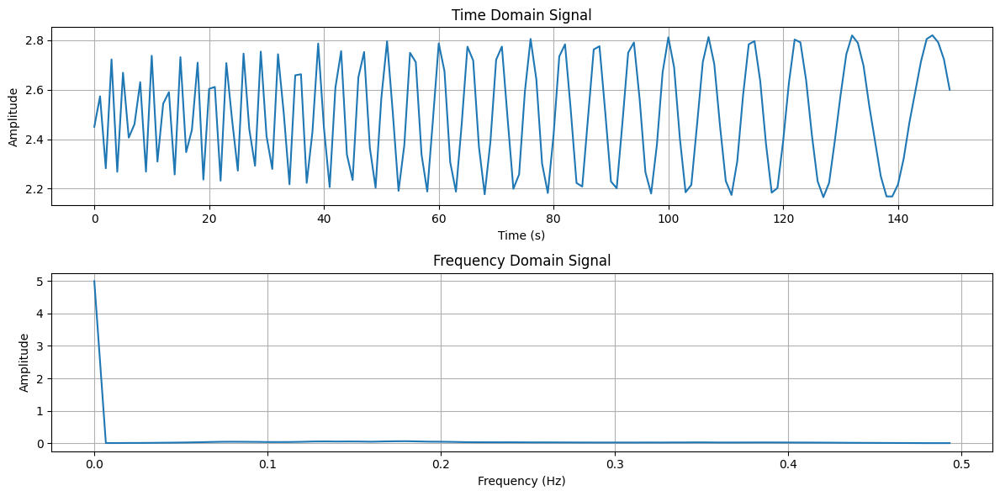

In [32]:
fft_df_healthy = perform_fft(df_healthy['Current-A'], df_healthy['Time'])

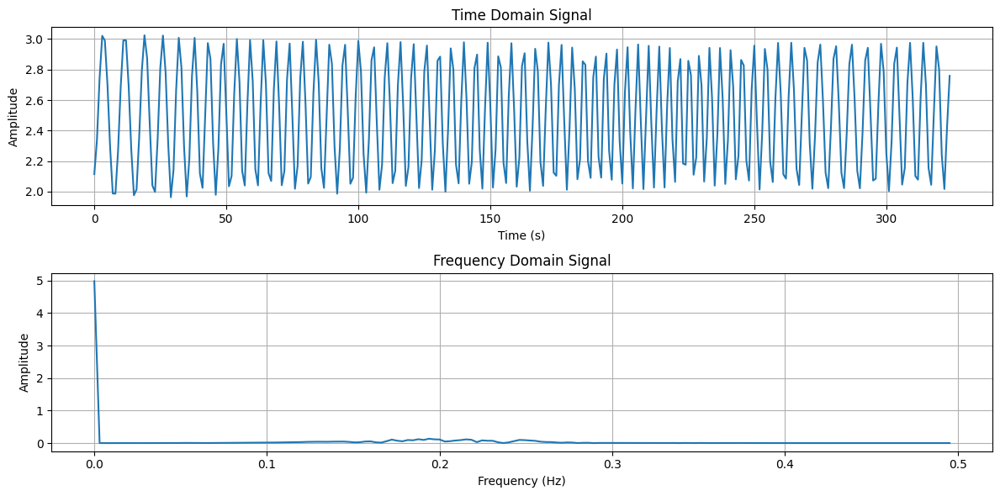

In [33]:
fft_df_unhealthy100 = perform_fft(df_unhealthy100['Current-A'], df_unhealthy100['Time'])

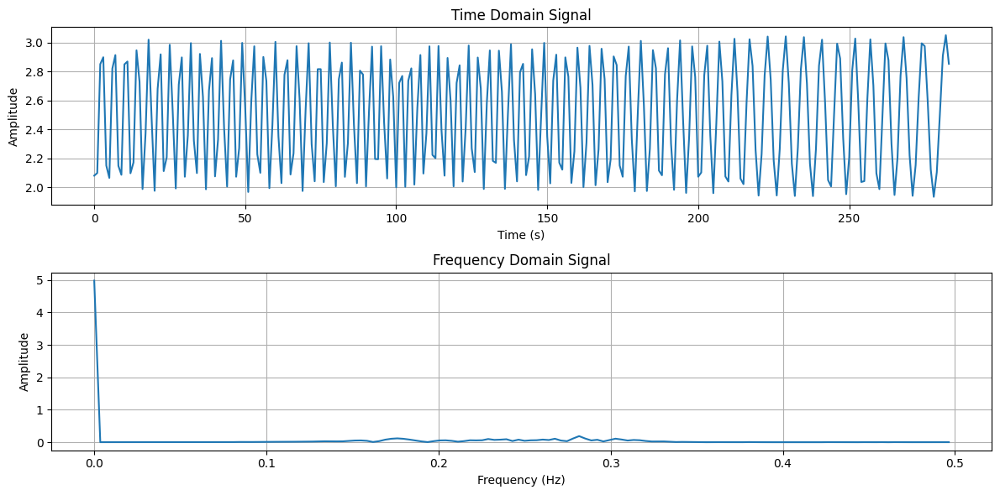

In [34]:
fft_df_unhealthy200 = perform_fft(df_unhealthy200['Current-A'], df_unhealthy200['Time'])

In [35]:
# Set the sampling frequency to 1 Hz (as per the user's data rate)
fs = 1  # 1 sample per second

# Recalculate the spectrogram with 1 Hz sampling frequency
frequencies_healthy, times, Sxx = spectrogram(df_healthy['Current-A'], fs=fs, nperseg=8, noverlap=4)

# Plot the spectrogram with the updated sampling frequency
plt.figure(figsize=(12, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.title('Spectrogram of healthy Current-A')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  # Nyquist frequency (0.5 Hz for 1 Hz sampling rate)
plt.grid(True)
plt.show()


NameError: name 'spectrogram' is not defined

In [ ]:
# Extract the dominant frequency at each time step from the spectrogram
dominant_frequencies = frequencies_healthy[np.argmax(Sxx, axis=0)]

# Plot the dominant frequency as a function of time
plt.figure(figsize=(10, 5))
plt.plot(times, dominant_frequencies, marker='o', linestyle='-', color='b')
plt.title('Dominant Frequency Over Time')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.grid(True)
plt.show()


In [ ]:
# Set the sampling frequency to 1 Hz (as per the user's data rate)
fs = 1  # 1 sample per second

# Recalculate the spectrogram with 1 Hz sampling frequency
frequencies_unhealthy100, times, Sxx = spectrogram(df_unhealthy100['Current-A'], fs=fs, nperseg=8, noverlap=4)

# Plot the spectrogram with the updated sampling frequency
plt.figure(figsize=(12, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.title('Spectrogram of unhealthy100 Current-A')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  # Nyquist frequency (0.5 Hz for 1 Hz sampling rate)
plt.grid(True)
plt.show()

In [ ]:
# Extract the dominant frequency at each time step from the spectrogram
dominant_frequencies = frequencies_unhealthy100[np.argmax(Sxx, axis=0)]

# Plot the dominant frequency as a function of time
plt.figure(figsize=(10, 5))
plt.plot(times, dominant_frequencies, marker='o', linestyle='-', color='b')
plt.title('Dominant Frequency Over Time')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.grid(True)
plt.show()


In [ ]:
# Set the sampling frequency to 1 Hz (as per the user's data rate)
fs = 1  # 1 sample per second

# Recalculate the spectrogram with 1 Hz sampling frequency
frequencies_unhealthy200, times, Sxx = spectrogram(df_unhealthy200['Current-A'], fs=fs, nperseg=8, noverlap=4)

# Plot the spectrogram with the updated sampling frequency
plt.figure(figsize=(12, 6))
plt.pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Power/Frequency (dB/Hz)')
plt.title('Spectrogram of unhealthy200 Current-A')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.ylim(0, fs / 2)  # Nyquist frequency (0.5 Hz for 1 Hz sampling rate)
plt.grid(True)
plt.show()

In [ ]:
# Extract the dominant frequency at each time step from the spectrogram
dominant_frequencies = frequencies_unhealthy100[np.argmax(Sxx, axis=0)]

# Plot the dominant frequency as a function of time
plt.figure(figsize=(10, 5))
plt.plot(times, dominant_frequencies, marker='o', linestyle='-', color='b')
plt.title('Dominant Frequency Over Time')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.grid(True)
plt.show()

# Analyse Data

## choose training set and validation set

In [123]:

X = df_final.drop(columns=['Malfunction'])  
y = df_final['Malfunction']                 

# 将数据分为训练集和测试集
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

## Create and Train KNN Model

In [124]:
k = 10
knn = KNeighborsClassifier(n_neighbors=k)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=10)

## Score the model

In [125]:
y_pred = knn.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"The accuracy of the model is : {accuracy:.2f}")

The accuracy of the model is : 1.00


## Plot the 3D figure of the model

d:\Python\Lib\site-packages\sklearn\base.py:493: UserWarning:

X does not have valid feature names, but KNeighborsClassifier was fitted with feature names



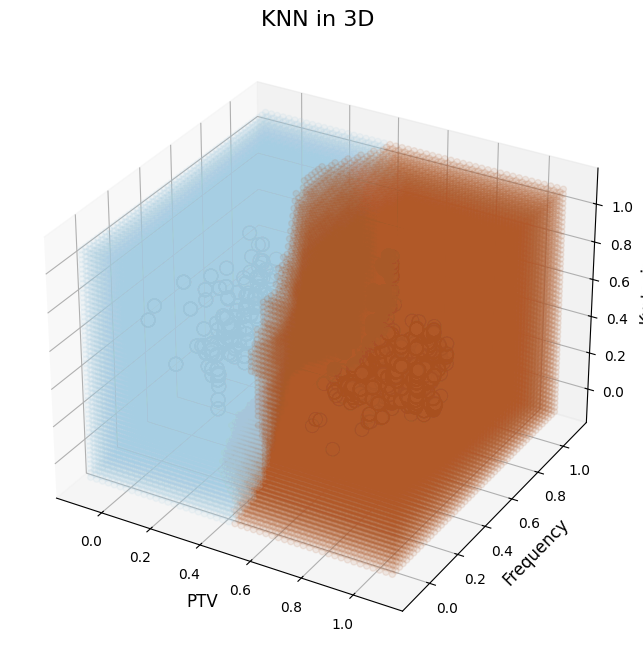

In [126]:

x_min, x_max = X['PTV'].min() - 0.1, X['PTV'].max() + 0.1
y_min, y_max = X['Frequency'].min() - 0.1, X['Frequency'].max() + 0.1
z_min, z_max = X['Kurtosis'].min() - 0.1, X['Kurtosis'].max() + 0.1

x_range = np.linspace(x_min, x_max, 50)
y_range = np.linspace(y_min, y_max, 50)
z_range = np.linspace(z_min, z_max, 50)
xx, yy, zz = np.meshgrid(x_range, y_range, z_range)


grid_points = np.c_[xx.ravel(), yy.ravel(), zz.ravel()]
predictions = knn.predict(grid_points)
predictions = predictions.reshape(xx.shape)


fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')


ax.scatter(xx.ravel(), yy.ravel(), zz.ravel(), c=predictions.ravel(), alpha=0.1, cmap=plt.cm.Paired)


ax.scatter(X['PTV'], X['Frequency'], X['Kurtosis'], c=y, edgecolor='k', cmap=plt.cm.Paired, s=100)


ax.set_title("KNN in 3D", fontsize=16)
ax.set_xlabel("PTV", fontsize=12)
ax.set_ylabel("Frequency", fontsize=12)
ax.set_zlabel("Kurtosis", fontsize=12)

plt.show()

In [127]:

scatter_data = pd.DataFrame({
    'PTV': xx.ravel(),
    'Frequency': yy.ravel(),
    'Kurtosis': zz.ravel(),
    'Prediction': predictions.ravel()
})


fig = go.Figure()


fig.add_trace(go.Scatter3d(
    x=scatter_data['PTV'],
    y=scatter_data['Frequency'],
    z=scatter_data['Kurtosis'],
    mode='markers',
    marker=dict(
        size=2,
        color=scatter_data['Prediction'],  
        colorscale='Viridis',
        opacity=0.5
    ),
    name='Boundary'
))


fig.add_trace(go.Scatter3d(
    x=X['PTV'],
    y=X['Frequency'],
    z=X['Kurtosis'],
    mode='markers',
    marker=dict(
        size=8,
        color=y,  
        colorscale='Viridis',
        line=dict(width=1, color='black')
    ),
    name='Original data'
))


fig.update_layout(
    title="Interactive KNN 3D",
    scene=dict(
        xaxis_title="PTV",
        yaxis_title="Frequency",
        zaxis_title="Kurtosis",
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)


fig.show()